In [1]:
import numpy as np 
import pandas as pd 
import cv2
import os
import matplotlib.pyplot as plt
import random
import math
from PIL import Image
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
def conv(img, kernel):
    kH,kW = kernel.shape
    (imH,imW) = img.shape
    new_img = np.zeros(img.shape)
    pad = int((kH-1)/2)
    
    for y in range(imH-kH):
        for x in range(imW-kW):
            window = img[y:y+kH,x:x+kW]
            new_img[y+pad,x+pad] = (kernel * window).sum()
    
    return new_img

In [3]:
def get_image():
    DATADIR = "/content/drive/MyDrive/train_ob"
    
    
    selected = False
    while(selected == False):
        rand = random.randrange(0,len(os.listdir(DATADIR)))
        img_name = (os.listdir(DATADIR))[rand]
        if img_name.endswith("jpg"):
            img = Image.open(os.path.join(DATADIR, (os.listdir(DATADIR))[rand])).convert('L')
            img_arr = np.asarray(img)
            selected = True

    return img_arr

In [4]:
def sobel_filter(img):
    sobelx = np.array([[-1,0,1],
                     [-2,0,2],
                     [-1,0,1]])

    sobely = np.array([[-1,-2,-1],
                     [0,0,0],
                     [1,2,1]])
    
    kH,kW = sobelx.shape
    (imH,imW) = img.shape
    new_img = np.zeros(img.shape)
    theta = np.zeros(img.shape)
    hsv_img = np.zeros((img.shape[0],img.shape[1],3))
    nms_img = np.zeros(img.shape)
    pad = int((kH-1)/2)
    
    for y in range(imH-kH):
        for x in range(imW-kW):
            window = img[y:y+kH,x:x+kW]
            new_img[y+pad,x+pad] = (((sobelx * window).sum())**2 + ((sobely * window).sum())**2)**0.5
            if(new_img[y+pad,x+pad] > 0):
                if((sobelx * window).sum() == 0):
                    theta[y+pad,x+pad] = 90
                else:
                    theta[y+pad,x+pad] = (math.degrees(math.atan((sobely * window).sum()/(sobelx * window).sum())))%180
                    
                    
                    
                    
    for i in range(imH-1):
        for j in range(imW-1):
            if(theta[i,j] != 0):
                quad = theta[i,j]//22.5
                neighborA = 255
                neighborB = 255

                if quad in [0,8]:
                    neighborA = new_img[i,j-1] #Left
                    neighborB = new_img[i,j+1] #Right
                elif quad in [1,2]:
                    neighborA = new_img[i-1,j-1] #LowerLeft
                    neighborB = new_img[i+1,j+1] #UpperRight
                elif quad in [5,6]:
                    neighborA = new_img[i-1,j+1] #LowerRight
                    neighborB = new_img[i+1,j-1] #UpperLeft
                elif quad in [3,4]:
                    neighborA = new_img[i-1,j] #Down
                    neighborB = new_img[i+1,j] #Up
                if(max([neighborA,new_img[i,j],neighborB]) == new_img[i,j] and new_img[i,j] >= 255 * 0.4):
                    nms_img[i,j] = new_img[i,j]
                    hsv_img[i,j,:] = [theta[i,j],255,255]
                
             
            
            
    return new_img.astype(np.uint8),hsv_img.astype(np.uint8),nms_img.astype(np.uint8)
            

In [5]:
img = get_image()
img = cv2.GaussianBlur(img,(3,3),0)

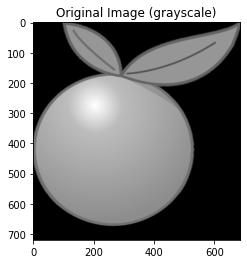

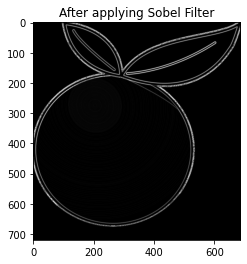

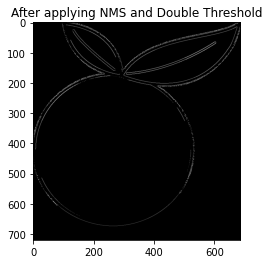

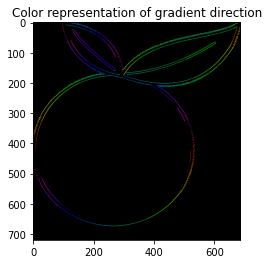

In [6]:
sobel_img,hsv_img,nms_img = sobel_filter(img)

plt.figure()
plt.title("Original Image (grayscale)")
plt.imshow(img,cmap='gray')
plt.figure()
plt.title("After applying Sobel Filter")
plt.imshow(sobel_img,cmap='gray')
plt.figure()
plt.title("After applying NMS and Double Threshold")
plt.imshow(nms_img,cmap='gray')
plt.figure()
plt.title("Color representation of gradient direction")
plt.imshow(cv2.cvtColor(hsv_img,cv2.COLOR_HSV2RGB))

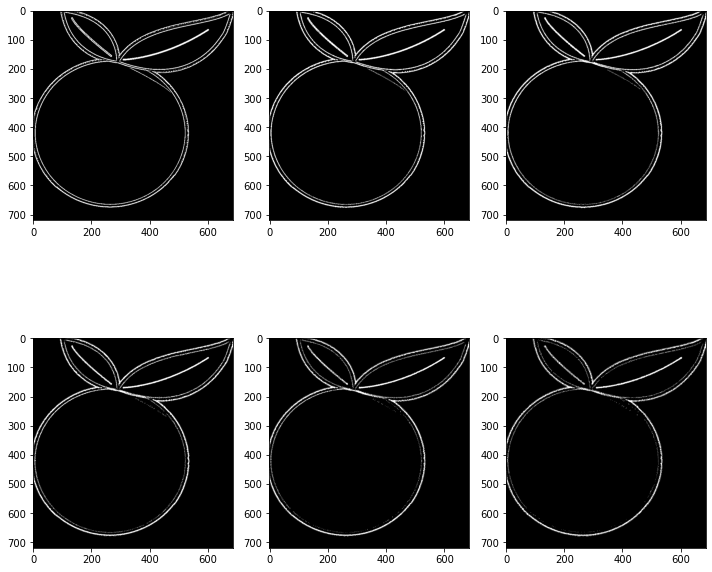

In [7]:
count = 0
blur = cv2.GaussianBlur(img,(3,3),0.5)
plt.figure(figsize=(10,10))
while(True):
    blur = cv2.GaussianBlur(blur,(3,3),0)
    new_blur = cv2.GaussianBlur(blur,(3,3),0)
    count+=1
    plt.subplot(2,3,count)
    plt.imshow((blur-new_blur),cmap="gray")
    if(count == 6):
        break
    blur = new_blur
plt.tight_layout()
plt.show()

In [8]:
data_jpg=[]
data_xml=[]

for filename in os.listdir("/content/drive/MyDrive/train_ob"):
    if filename.split('.')[1] == 'jpg':
        data_jpg.append("/content/drive/MyDrive/train_ob/"+filename)
    else :
        data_xml.append("/content/drive/MyDrive/train_ob/"+filename)

data_jpg.sort()
data_xml.sort()

X_train=y_train=data_jpg
X_test=y_test=data_xml

print(data_jpg[0],data_xml[0])

/content/drive/MyDrive/train_ob/apple_1.jpg /content/drive/MyDrive/train_ob/apple_1.xml


In [9]:
print(len(data_jpg),len(data_xml))

240 240


In [10]:
from xml.etree.ElementTree import parse
test_sample=7
random_state=0.2
object_xmin=[]
object_ymin=[]
object_xmax=[]
object_ymax=[]
import sys
sys.path.insert(0,"/content/drive/My Drive/utils/")
import visualization_utils
weights_path='/content/drive/My Drive/utils/yolov3_weights'
#visualization_utils.predict(X_train,y_train)
print("Yolo Accuracy:"+str(visualization_utils.model_score(test_sample,random_state)))
for i in range(len(data_xml)):
    root_=parse(data_xml[i])
    root=root_.getroot()
    objects = root.findall("object")
    object_xmin.append([int(x.find("bndbox").findtext("xmin")) for x in objects])
    object_ymin.append([int(x.find("bndbox").findtext("ymin")) for x in objects])
    object_xmax.append([int(x.find("bndbox").findtext("xmax")) for x in objects])
    object_ymax.append([int(x.find("bndbox").findtext("ymax")) for x in objects])

Yolo Accuracy:0.91


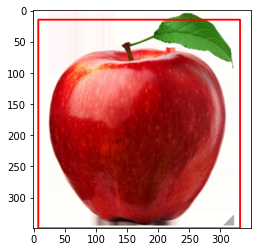

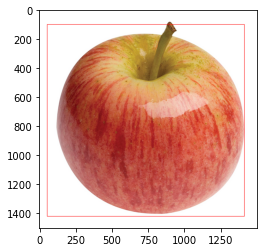

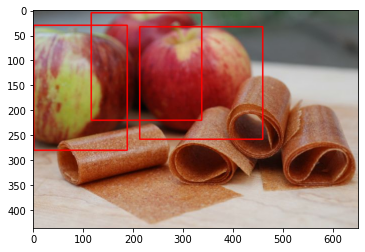

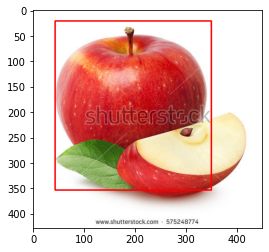

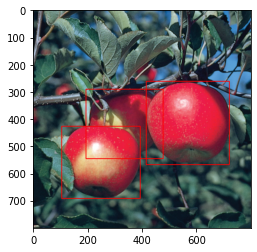

...

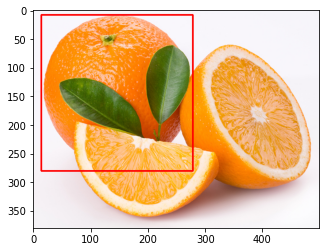

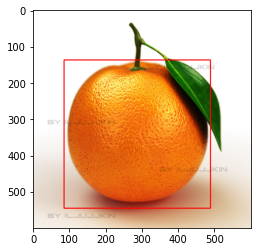

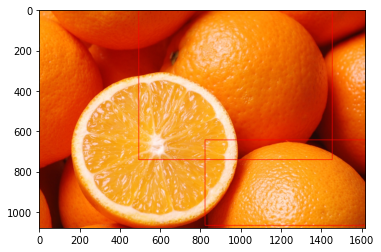

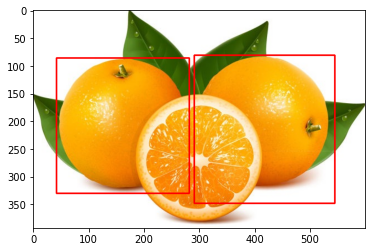

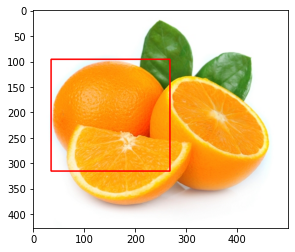

In [11]:
import cv2
import matplotlib.pyplot as plt

for i in range(len(data_jpg)):
    img = cv2.imread(data_jpg[i])
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    for j in range(len(object_xmin[i])):
        output=cv2.rectangle(img,(object_xmin[i][j],object_ymin[i][j]),(object_xmax[i][j],object_ymax[i][j]),(255,0,0),2)
    plt.imshow(output)
    plt.show()

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


(93.0, 95.0)

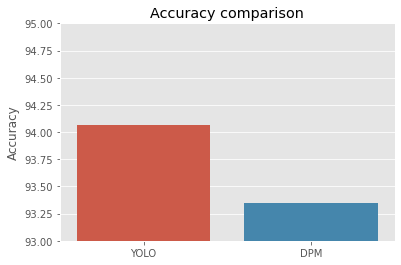

In [12]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import math
plt.style.use('ggplot')
x=['YOLO','DPM']
accuracy=[94.06223,93.35]

ax=sns.barplot(x,accuracy)
ax.set_title('Accuracy comparison')
ax.set_ylabel('Accuracy')

low = min(accuracy)
high = max(accuracy)
ax.set_ylim([math.ceil(low-0.5*(high-low)), math.ceil(high+0.5*(high-low))])